# Fetal_Health_Prediction

# Step 1 :
Imported the libraries and load the initial dataset - fetal_health.csv.

In [1]:
import numpy as np
import pandas as pd

In [2]:
import pandas as pd
file_path = 'fetal_health.csv'
data = pd.read_csv(file_path)
print(data.head())

   baseline value  accelerations  fetal_movement  uterine_contractions  \
0           120.0          0.000             0.0                 0.000   
1           132.0          0.006             0.0                 0.006   
2           133.0          0.003             0.0                 0.008   
3           134.0          0.003             0.0                 0.008   
4           132.0          0.007             0.0                 0.008   

   light_decelerations  severe_decelerations  prolongued_decelerations  \
0                0.000                   0.0                       0.0   
1                0.003                   0.0                       0.0   
2                0.003                   0.0                       0.0   
3                0.003                   0.0                       0.0   
4                0.000                   0.0                       0.0   

   abnormal_short_term_variability  mean_value_of_short_term_variability  \
0                             73.0

# Step 2 : 
Look into the data informations to check for any null values.

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

In [4]:
data.isnull().sum()

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

# Step 3:
Check for any duplicates and if they are present we keep the first unique value and remove all other duplicates.

In [5]:
data.duplicated().sum()

13

In [6]:
data.drop_duplicates(keep='first', inplace=True)
data.duplicated().sum()

0

# Step 4: 
Perform 3NF and merge back the data into a single dataset as it was intially ,i.e, we have performed data preparation, normalization, and merged our database containing fetal health data into a single csv - fetal_health_from_db.csv.

In [8]:
import sqlite3
import pandas as pd

# Load your dataset
file_path = 'fetal_health.csv'  # Update with your file path
df = pd.read_csv(file_path)

# Data cleanup (as done before)
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('-', '_')
df.rename(columns={'prolongued_decelerations': 'prolonged_decelerations'}, inplace=True)

# Create a connection to the SQLite database (this creates a file called 'fetal_health.db')
conn = sqlite3.connect('fetal_health.db')
cursor = conn.cursor()

# Step 1: Create tables in the database
# Measurements table
cursor.execute('''
    CREATE TABLE IF NOT EXISTS measurements (
        measurement_id INTEGER PRIMARY KEY AUTOINCREMENT,
        baseline_value REAL,
        accelerations REAL,
        fetal_movement REAL,
        uterine_contractions REAL,
        light_decelerations REAL,
        severe_decelerations REAL,
        prolonged_decelerations REAL
    )
''')

# Histogram table
cursor.execute('''
    CREATE TABLE IF NOT EXISTS histogram (
        histogram_id INTEGER PRIMARY KEY AUTOINCREMENT,
        histogram_width REAL,
        histogram_min REAL,
        histogram_max REAL,
        histogram_number_of_peaks REAL,
        histogram_number_of_zeroes REAL,
        histogram_mode REAL,
        histogram_mean REAL,
        histogram_median REAL,
        histogram_variance REAL,
        histogram_tendency REAL
    )
''')

# Variability table
cursor.execute('''
    CREATE TABLE IF NOT EXISTS variability (
        variability_id INTEGER PRIMARY KEY AUTOINCREMENT,
        abnormal_short_term_variability REAL,
        mean_value_of_short_term_variability REAL,
        percentage_of_time_with_abnormal_long_term_variability REAL,
        mean_value_of_long_term_variability REAL
    )
''')

# Fetal Health table
cursor.execute('''
    CREATE TABLE IF NOT EXISTS fetal_health (
        fetal_health_id INTEGER PRIMARY KEY AUTOINCREMENT,
        fetal_health INTEGER
    )
''')

# Main table (Links all the above tables)
cursor.execute('''
    CREATE TABLE IF NOT EXISTS main_table (
        record_id INTEGER PRIMARY KEY AUTOINCREMENT,
        measurement_id INTEGER,
        histogram_id INTEGER,
        variability_id INTEGER,
        fetal_health_id INTEGER,
        FOREIGN KEY (measurement_id) REFERENCES measurements(measurement_id),
        FOREIGN KEY (histogram_id) REFERENCES histogram(histogram_id),
        FOREIGN KEY (variability_id) REFERENCES variability(variability_id),
        FOREIGN KEY (fetal_health_id) REFERENCES fetal_health(fetal_health_id)
    )
''')

# Step 2: Insert data into the tables
# Insert data into the 'fetal_health' table (without dropping duplicates)
fetal_health_data = df[['fetal_health']].copy()
fetal_health_data['fetal_health_id'] = range(1, len(fetal_health_data) + 1)
fetal_health_data.to_sql('fetal_health', conn, if_exists='replace', index=False)

# Insert data into the 'measurements' table
measurements_columns = [
    'baseline_value', 'accelerations', 'fetal_movement', 'uterine_contractions',
    'light_decelerations', 'severe_decelerations', 'prolonged_decelerations'
]
measurements_data = df[measurements_columns].drop_duplicates()
measurements_data['measurement_id'] = range(1, len(measurements_data) + 1)
measurements_data.to_sql('measurements', conn, if_exists='replace', index=False)

# Insert data into the 'histogram' table
histogram_columns = [
    'histogram_width', 'histogram_min', 'histogram_max', 'histogram_number_of_peaks',
    'histogram_number_of_zeroes', 'histogram_mode', 'histogram_mean', 'histogram_median',
    'histogram_variance', 'histogram_tendency'
]
histogram_data = df[histogram_columns].drop_duplicates()
histogram_data['histogram_id'] = range(1, len(histogram_data) + 1)
histogram_data.to_sql('histogram', conn, if_exists='replace', index=False)

# Insert data into the 'variability' table
variability_columns = [
    'abnormal_short_term_variability', 'mean_value_of_short_term_variability',
    'percentage_of_time_with_abnormal_long_term_variability', 'mean_value_of_long_term_variability'
]
variability_data = df[variability_columns].drop_duplicates()
variability_data['variability_id'] = range(1, len(variability_data) + 1)
variability_data.to_sql('variability', conn, if_exists='replace', index=False)

# Insert data into the 'main_table'
main_table_data = pd.DataFrame({
    'measurement_id': measurements_data['measurement_id'],
    'histogram_id': histogram_data['histogram_id'],
    'variability_id': variability_data['variability_id'],
    'fetal_health_id': fetal_health_data['fetal_health_id']
})
main_table_data['record_id'] = range(1, len(main_table_data) + 1)
main_table_data.to_sql('main_table', conn, if_exists='replace', index=False)



print("Data inserted into the database and saved as 'fetal_health.db'.")


Data inserted into the database and saved as 'fetal_health.db'.


In [9]:
# Check all tables in the database
cursor.execute("SELECT name FROM sqlite_master WHERE type='table';")
tables = cursor.fetchall()
print("Tables in the database:")
for table in tables:
    print(table[0])  # Print each table's name


Tables in the database:
sqlite_sequence
fetal_health
measurements
histogram
variability
main_table


In [10]:
# Check the structure of a specific table (e.g., 'main_table')
cursor.execute("PRAGMA table_info(main_table);")
columns = cursor.fetchall()
print("\nColumns in 'main_table':")
for column in columns:
    print(column)



Columns in 'main_table':
(0, 'measurement_id', 'REAL', 0, None, 0)
(1, 'histogram_id', 'REAL', 0, None, 0)
(2, 'variability_id', 'REAL', 0, None, 0)
(3, 'fetal_health_id', 'INTEGER', 0, None, 0)
(4, 'record_id', 'INTEGER', 0, None, 0)


In [11]:
# Query some rows from the 'main_table' to inspect the data
cursor.execute("SELECT * FROM main_table LIMIT 10;")
rows = cursor.fetchall()
print("\nSample data from 'main_table':")
for row in rows:
    print(row)



Sample data from 'main_table':
(1.0, 1.0, 1.0, 1, 1)
(2.0, 2.0, 2.0, 2, 2)
(3.0, 3.0, 3.0, 3, 3)
(4.0, 4.0, 4.0, 4, 4)
(5.0, 5.0, 5.0, 5, 5)
(6.0, 6.0, 6.0, 6, 6)
(7.0, 7.0, 7.0, 7, 7)
(8.0, 8.0, 8.0, 8, 8)
(9.0, None, 9.0, 9, 9)
(10.0, 9.0, 10.0, 10, 10)


In [12]:
# Enable foreign key constraints
cursor.execute("PRAGMA foreign_keys = ON;")


In [13]:
# Check if foreign keys are enabled
cursor.execute("PRAGMA foreign_keys;")
foreign_keys_enabled = cursor.fetchone()
print("\nForeign keys enabled:", foreign_keys_enabled[0] == 1)



Foreign keys enabled: True


In [14]:
# Connect to the SQLite database
import sqlite3

connection = sqlite3.connect("fetal_health.db")
cursor = connection.cursor()

# Update all columns with NULL values to 0.00 in the measurements table
cursor.execute("UPDATE measurements SET baseline_value = 0.00 WHERE baseline_value IS NULL")
cursor.execute("UPDATE measurements SET accelerations = 0.00 WHERE accelerations IS NULL")
cursor.execute("UPDATE measurements SET fetal_movement = 0.00 WHERE fetal_movement IS NULL")
cursor.execute("UPDATE measurements SET uterine_contractions = 0.00 WHERE uterine_contractions IS NULL")
cursor.execute("UPDATE measurements SET light_decelerations = 0.00 WHERE light_decelerations IS NULL")
cursor.execute("UPDATE measurements SET severe_decelerations = 0.00 WHERE severe_decelerations IS NULL")
cursor.execute("UPDATE measurements SET prolonged_decelerations = 0.00 WHERE prolonged_decelerations IS NULL")

# Commit changes and close the connection



This is where we work on merging the data back to a single csv 

In [15]:
import sqlite3
import csv

# Connect to the SQLite database
conn = sqlite3.connect('fetal_health.db')
cursor = conn.cursor()

# Join all tables based on their foreign key relationships
query = """
    SELECT 
        main_table.record_id, 
        measurements.*, 
        histogram.*, 
        variability.*, 
        fetal_health.fetal_health 
    FROM main_table
    JOIN measurements ON main_table.measurement_id = measurements.measurement_id
    JOIN histogram ON main_table.histogram_id = histogram.histogram_id
    JOIN variability ON main_table.variability_id = variability.variability_id
    JOIN fetal_health ON main_table.fetal_health_id = fetal_health.fetal_health_id
"""

# Execute the query
cursor.execute(query)

# Fetch the data
rows = cursor.fetchall()

# Get the column names (first get columns from each table)
measurement_columns = [description[0] for description in cursor.description]

# Write to a single CSV file
with open('merged_data.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    
    # Write the header (column names)
    writer.writerow(measurement_columns)
    
    # Write the data
    writer.writerows(rows)

print("All data exported to 'merged_data.csv'")




All data exported to 'merged_data.csv'


In [17]:
import sqlite3
import pandas as pd

# Create a connection to the SQLite database (using the existing database file)
conn = sqlite3.connect('fetal_health.db')

# Query data from each table and convert it to a DataFrame
measurements_df = pd.read_sql_query("SELECT * FROM measurements", conn)
histogram_df = pd.read_sql_query("SELECT * FROM histogram", conn)
variability_df = pd.read_sql_query("SELECT * FROM variability", conn)
fetal_health_df = pd.read_sql_query("SELECT * FROM fetal_health", conn)
main_table_df = pd.read_sql_query("SELECT * FROM main_table", conn)

# Check for NaN values in main_table for 'fetal_health_id'
print(main_table_df['fetal_health_id'].isna().sum())  # Check how many NaN values in fetal_health_id

# Check if 'fetal_health_id' values in the main table match with those in the fetal_health table
print(fetal_health_df['fetal_health_id'].unique())  # Check unique IDs in fetal_health
print(main_table_df['fetal_health_id'].unique())   # Check unique IDs in main_table

# Clean up 'fetal_health_id' in main_table by filling NaN with an appropriate value (e.g., 0 or remove rows with NaN)
# Optionally, you can choose to drop rows with NaN in 'fetal_health_id' if that’s suitable
main_table_df = main_table_df.dropna(subset=['fetal_health_id'])

# Ensure 'fetal_health_id' is an integer type to avoid mismatches
main_table_df['fetal_health_id'] = main_table_df['fetal_health_id'].astype(int)

# Merge the data into a single DataFrame based on foreign key relationships
merged_df = main_table_df \
    .merge(measurements_df, on='measurement_id', how='left') \
    .merge(histogram_df, on='histogram_id', how='left') \
    .merge(variability_df, on='variability_id', how='left') \
    .merge(fetal_health_df, on='fetal_health_id', how='left')

# Check if the merge worked and there are no NaN values in 'fetal_health_id' and 'fetal_health'
print(merged_df[['fetal_health_id', 'fetal_health']].head(10))  # Print the first few rows

# Save the merged DataFrame to a single CSV file
merged_df.to_csv('merged_fetal_health.csv', index=False)

# Close the connection
conn.close()

print("Data has been exported to a single CSV file: 'merged_fetal_health.csv'.")


0
[   1    2    3 ... 2124 2125 2126]
[   1    2    3 ... 2124 2125 2126]
   fetal_health_id  fetal_health
0                1           2.0
1                2           1.0
2                3           1.0
3                4           1.0
4                5           1.0
5                6           3.0
6                7           3.0
7                8           3.0
8                9           3.0
9               10           3.0
Data has been exported to a single CSV file: 'merged_fetal_health.csv'.


In [18]:
import sqlite3

# Create a connection to the SQLite database
conn = sqlite3.connect('fetal_health.db')

# Query to retrieve fetal_health_id and fetal_health from the fetal_health table
query = "SELECT fetal_health_id, fetal_health FROM fetal_health"

# Execute the query and fetch the results into a DataFrame
fetal_health_df = pd.read_sql_query(query, conn)

# Display the retrieved data
print(fetal_health_df)

# Close the connection
conn.close()


      fetal_health_id  fetal_health
0                   1           2.0
1                   2           1.0
2                   3           1.0
3                   4           1.0
4                   5           1.0
...               ...           ...
2121             2122           2.0
2122             2123           2.0
2123             2124           2.0
2124             2125           2.0
2125             2126           1.0

[2126 rows x 2 columns]


In [19]:
import sqlite3
import pandas as pd

# Connect to the SQLite database
conn = sqlite3.connect('fetal_health.db')

# Create a query to join all the tables and get the required columns
query = """
    SELECT 
        main_table.record_id,
        measurements.baseline_value,
        measurements.accelerations,
        measurements.fetal_movement,
        measurements.uterine_contractions,
        measurements.light_decelerations,
        measurements.severe_decelerations,
        measurements.prolonged_decelerations,
        histogram.histogram_width,
        histogram.histogram_min,
        histogram.histogram_max,
        histogram.histogram_number_of_peaks,
        histogram.histogram_number_of_zeroes,
        histogram.histogram_mode,
        histogram.histogram_mean,
        histogram.histogram_median,
        histogram.histogram_variance,
        histogram.histogram_tendency,
        variability.abnormal_short_term_variability,
        variability.mean_value_of_short_term_variability,
        variability.percentage_of_time_with_abnormal_long_term_variability,
        variability.mean_value_of_long_term_variability,
        fetal_health.fetal_health
    FROM main_table
    JOIN measurements ON main_table.measurement_id = measurements.measurement_id
    JOIN histogram ON main_table.histogram_id = histogram.histogram_id
    JOIN variability ON main_table.variability_id = variability.variability_id
    JOIN fetal_health ON main_table.fetal_health_id = fetal_health.fetal_health_id
"""

# Execute the query and fetch the data into a pandas DataFrame
df_from_db = pd.read_sql(query, conn)

# Optionally clean column names to match the original CSV (if needed)
df_from_db.columns = df_from_db.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('-', '_')

# Save the resulting DataFrame as a CSV
df_from_db.to_csv('fetal_health_from_db.csv', index=False)

# Close the database connection
conn.close()

print("Database has been successfully converted to 'fetal_health_from_db.csv'.")


Database has been successfully converted to 'fetal_health_from_db.csv'.


Here is the dataset we achieve from the database.

In [20]:
df= pd.read_csv('fetal_health_from_db.csv')

In [21]:
df[:23]

,record_id,baseline_value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolonged_decelerations,histogram_width,histogram_min,...,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,fetal_health
0,1,120.0,0.000,0.000,0.000,0.000,0.0,0.000,64.0,62.0,...,120.0,137.0,121.0,73.0,1.0,73.0,0.5,43.0,2.4,2.0
1,2,132.0,0.006,0.000,0.006,0.003,0.0,0.000,130.0,68.0,...,141.0,136.0,140.0,12.0,0.0,17.0,2.1,0.0,10.4,1.0
2,3,133.0,0.003,0.000,0.008,0.003,0.0,0.000,130.0,68.0,...,141.0,135.0,138.0,13.0,0.0,16.0,2.1,0.0,13.4,1.0
3,4,134.0,0.003,0.000,0.008,0.003,0.0,0.000,117.0,53.0,...,137.0,134.0,137.0,13.0,1.0,16.0,2.4,0.0,23.0,1.0
4,5,132.0,0.007,0.000,0.008,0.000,0.0,0.000,117.0,53.0,...,137.0,136.0,138.0,11.0,1.0,16.0,2.4,0.0,19.9,1.0
5,6,134.0,0.001,0.000,0.010,0.009,0.0,0.002,150.0,50.0,...,76.0,107.0,107.0,170.0,0.0,26.0,5.9,0.0,0.0,3.0
6,7,134.0,0.001,0.000,0.013,0.008,0.0,0.003,150.0,50.0,...,71.0,107.0,106.0,215.0,0.0,29.0,6.3,0.0,0.0,3.0
7,8,122.0,0.000,0.000,0.000,0.000,0.0,0.000,68.0,62.0,...,122.0,122.0,123.0,3.0,1.0,83.0,0.5,6.0,15.6,3.0
8,10,122.0,0.000,0.000,0.003,0.000,0.0,0.000,68.0,62.0,...,122.0,122.0,123.0,1.0,1.0,86.0,0.3,6.0,10.6,3.0
9,11,151.0,0.000,0.000,0.001,0.001,0.0,0.000,130.0,56.0,...,150.0,148.0,151.0,9.0,1.0,64.0,1.9,9.0,27.6,2.0


In [22]:
df

,record_id,baseline_value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolonged_decelerations,histogram_width,histogram_min,...,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,fetal_health
0,1,120.0,0.000,0.000,0.000,0.000,0.0,0.0,64.0,62.0,...,120.0,137.0,121.0,73.0,1.0,73.0,0.5,43.0,2.4,2.0
1,2,132.0,0.006,0.000,0.006,0.003,0.0,0.0,130.0,68.0,...,141.0,136.0,140.0,12.0,0.0,17.0,2.1,0.0,10.4,1.0
2,3,133.0,0.003,0.000,0.008,0.003,0.0,0.0,130.0,68.0,...,141.0,135.0,138.0,13.0,0.0,16.0,2.1,0.0,13.4,1.0
3,4,134.0,0.003,0.000,0.008,0.003,0.0,0.0,117.0,53.0,...,137.0,134.0,137.0,13.0,1.0,16.0,2.4,0.0,23.0,1.0
4,5,132.0,0.007,0.000,0.008,0.000,0.0,0.0,117.0,53.0,...,137.0,136.0,138.0,11.0,1.0,16.0,2.4,0.0,19.9,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1703,2121,140.0,0.000,0.000,0.005,0.001,0.0,0.0,31.0,124.0,...,145.0,143.0,145.0,2.0,0.0,77.0,0.7,17.0,6.0,1.0
1704,2122,140.0,0.000,0.000,0.007,0.000,0.0,0.0,40.0,137.0,...,153.0,150.0,152.0,2.0,0.0,79.0,0.2,25.0,7.2,2.0
1705,2123,140.0,0.001,0.000,0.007,0.000,0.0,0.0,66.0,103.0,...,152.0,148.0,151.0,3.0,1.0,78.0,0.4,22.0,7.1,2.0
1706,2125,140.0,0.001,0.000,0.006,0.000,0.0,0.0,66.0,103.0,...,152.0,147.0,151.0,4.0,1.0,78.0,0.4,27.0,7.0,2.0


# Step 5:
Check the new csv file achived from the database for any inconsistencies and errors. To do so we use ydata_profiling as shown below : 

In [23]:
pip install ydata_profiling 


  Using cached dacite-1.8.1-py3-none-any.whl.metadata (15 kB)
Using cached dacite-1.8.1-py3-none-any.whl (14 kB)
  Attempting uninstall: dacite
    Found existing installation: dacite 1.6.0
    Uninstalling dacite-1.6.0:
      Successfully uninstalled dacite-1.6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dagshub 0.4.0 requires dacite~=1.6.0, but you have dacite 1.8.1 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [24]:
from ydata_profiling import ProfileReport


profile = ProfileReport(df, title="Report on fetal health csv", explorative=True)
profile 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Step 6: 
Plot a Correlation matrix to check for highly correlated variables that may give unnecessary noise to the model.

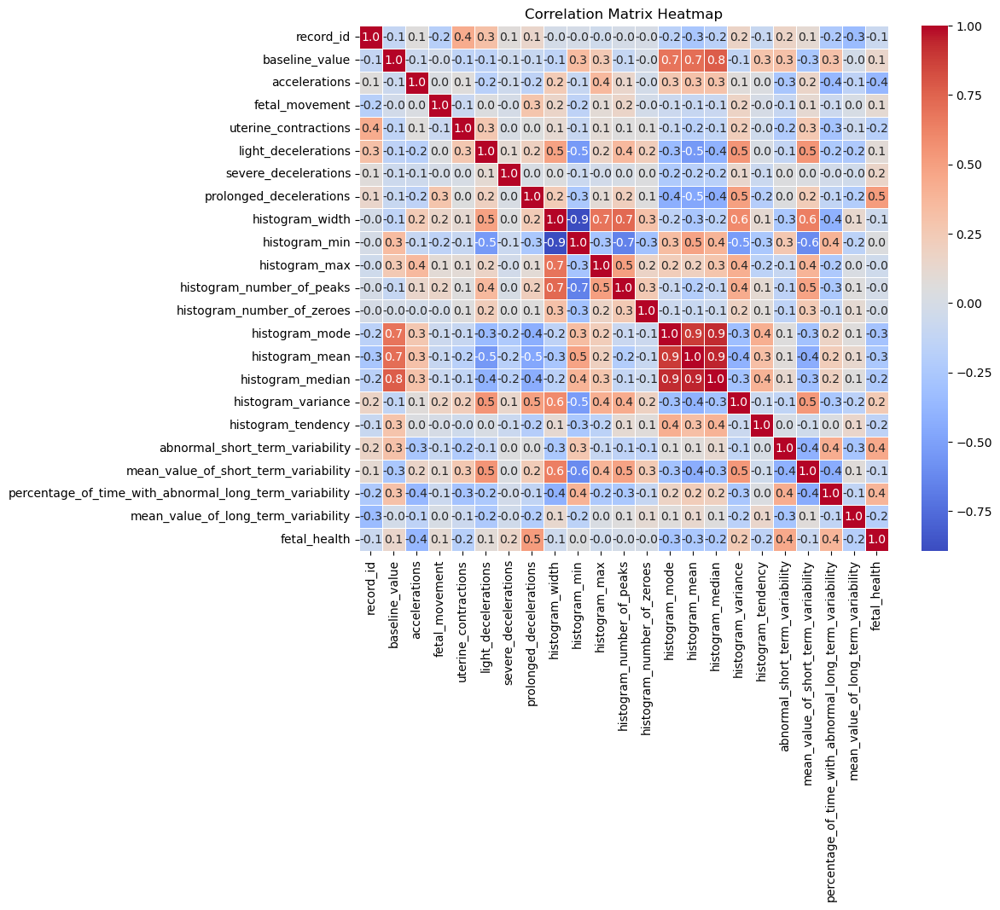

In [25]:
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
# Select only numerical columns


# Compute the correlation matrix for numerical columns
correlation_matrix = df.corr()

# Display the correlation matrix


plt.figure(figsize=(10, 8))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".1f", linewidths=0.5)
plt.title("Correlation Matrix Heatmap")
plt.show()

# Step 7:
Here we perform Stratification which basically checks the equal division between testing and training data that we use for our models further below.
And as we can see here our test and train both has equal amount of data.

In [26]:
from sklearn.model_selection import train_test_split
strat_train_set, strat_test_set = train_test_split(df, test_size=0.20, stratify=df["fetal_health"], random_state=42)
strat_train_set["fetal_health"].value_counts() / len(strat_train_set)

fetal_health
1.0    0.806735
2.0    0.118594
3.0    0.074671
Name: count, dtype: float64

In [27]:
strat_test_set["fetal_health"].value_counts() / len(strat_test_set)

fetal_health
1.0    0.807018
2.0    0.116959
3.0    0.076023
Name: count, dtype: float64

In [28]:
fetal = strat_train_set.drop("fetal_health",axis = 1)
fetal_labels = strat_train_set["fetal_health"].copy()

# Step 8: 
Creating Pipeline : 
Here we create a pipeline and perform logistic regression after which we impute its resulted metrics such as - accuracies, F1 score and cofusion matrix into DAGSHUB.

In [29]:
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, cross_validate
from sklearn.metrics import f1_score, confusion_matrix

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()

# Preprocessing steps
numerical_features = fetal.columns.tolist()

numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, numerical_features)
])

# Logistic Regression pipeline
logreg = LogisticRegression()
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', logreg)
])

# Parameter tuning for Logistic Regression
param_grid = {
    'classifier__C': [0.1, 1, 10],
    'classifier__solver': ['liblinear', 'lbfgs'],
    'classifier__penalty': ['l2'],
}

grid_search = GridSearchCV(pipeline, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

# Fit the model
grid_search.fit(fetal, fetal_labels)

# Best parameters and CV results
best_model = grid_search.best_estimator_
print("Best parameters:", grid_search.best_params_)

# Cross-validation results
cv_results_3fold = cross_validate(best_model, fetal, fetal_labels, cv=3, scoring='accuracy', return_train_score=True)
cv_results_10fold = cross_validate(best_model, fetal, fetal_labels, cv=10, scoring='accuracy', return_train_score=True)

# Results
print("3-Fold CV Accuracy Mean:", np.mean(cv_results_3fold['test_score']))
print("3-Fold CV Accuracy Std:", np.std(cv_results_3fold['test_score']))
print("10-Fold CV Accuracy Mean:", np.mean(cv_results_10fold['test_score']))
print("10-Fold CV Accuracy Std:", np.std(cv_results_10fold['test_score']))

# Whole training data evaluation
y_pred_train = best_model.predict(fetal)
train_f1 = f1_score(fetal_labels, y_pred_train, average='macro')
train_cm = confusion_matrix(fetal_labels, y_pred_train)

print("F1-Score on Training Data:", train_f1)
print("Confusion Matrix on Training Data:")
print(train_cm)


Best parameters: {'classifier__C': 10, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}
3-Fold CV Accuracy Mean: 0.9187487950645844
3-Fold CV Accuracy Std: 0.008133313697348765
10-Fold CV Accuracy Mean: 0.9194772434521253
10-Fold CV Accuracy Std: 0.021164688424053422
F1-Score on Training Data: 0.8330057619187236
Confusion Matrix on Training Data:
[[1074   23    5]
 [  43  114    5]
 [   7   18   77]]


In [30]:
%pip install dagshub mlflow

  Using cached dacite-1.6.0-py3-none-any.whl.metadata (14 kB)
Using cached dacite-1.6.0-py3-none-any.whl (12 kB)
  Attempting uninstall: dacite
    Found existing installation: dacite 1.8.1
    Uninstalling dacite-1.8.1:
      Successfully uninstalled dacite-1.8.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ydata-profiling 4.12.1 requires dacite>=1.8, but you have dacite 1.6.0 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


# Step 9:
DAGSHUB ML FLOW : 
Here we create the dagshub and after using pipelines and performing logistic regression we imputed the resulted metrics into this ml flow.

In [32]:
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, cross_validate
from sklearn.metrics import f1_score, confusion_matrix
import mlflow
import dagshub
from mlflow.models.signature import infer_signature

# Initialize DagsHub with token
dagshub.init(repo_owner='HariniMurugan-2003', repo_name='Fetal_health_Fall24', mlflow=True)

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()

# Preprocessing steps
numerical_features = fetal.columns.tolist()

numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, numerical_features)
])

# Logistic Regression pipeline
logreg = LogisticRegression()
logreg_model = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', logreg)
])

# Parameter tuning for Logistic Regression
param_grid = {
    'classifier__C': [0.1, 1, 10],
    'classifier__solver': ['liblinear', 'lbfgs'],
    'classifier__penalty': ['l2'],
}

grid_search = GridSearchCV(logreg_model, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

# Fit the model
with mlflow.start_run(run_name="Logistic Regression") as run:
    grid_search.fit(fetal, fetal_labels)

    # Log best parameters
    best_params = grid_search.best_params_
    mlflow.log_params(best_params)

    # Best parameters and CV results
    best_model = grid_search.best_estimator_
    print("Best parameters:", best_params)

    # Cross-validation results
    cv_results_3fold = cross_validate(best_model, fetal, fetal_labels, cv=3, scoring='accuracy', return_train_score=True)
    cv_results_10fold = cross_validate(best_model, fetal, fetal_labels, cv=10, scoring='accuracy', return_train_score=True)

    # Log CV results
    mlflow.log_metric("3-Fold CV Accuracy Mean", np.mean(cv_results_3fold['test_score']))
    mlflow.log_metric("3-Fold CV Accuracy Std", np.std(cv_results_3fold['test_score']))
    mlflow.log_metric("10-Fold CV Accuracy Mean", np.mean(cv_results_10fold['test_score']))
    mlflow.log_metric("10-Fold CV Accuracy Std", np.std(cv_results_10fold['test_score']))

    # Results
    print("3-Fold CV Accuracy Mean:", np.mean(cv_results_3fold['test_score']))
    print("3-Fold CV Accuracy Std:", np.std(cv_results_3fold['test_score']))
    print("10-Fold CV Accuracy Mean:", np.mean(cv_results_10fold['test_score']))
    print("10-Fold CV Accuracy Std:", np.std(cv_results_10fold['test_score']))

    # Whole training data evaluation
    y_pred_train = best_model.predict(fetal)
    train_f1 = f1_score(fetal_labels, y_pred_train, average='macro')
    train_cm = confusion_matrix(fetal_labels, y_pred_train)

    # Log training data results
    mlflow.log_metric("F1-Score on Training Data", train_f1)
    print("F1-Score on Training Data:", train_f1)
    print("Confusion Matrix on Training Data:")
    print(train_cm)

    # Infer model signature
    signature = infer_signature(fetal, y_pred_train)

    # Register model in DagsHub
    mlflow.sklearn.log_model(best_model, "logistic_regression_model", signature=signature)


Initialized MLflow to track repo "HariniMurugan-2003/Fetal_health_Fall24"

Repository HariniMurugan-2003/Fetal_health_Fall24 initialized!

Best parameters: {'classifier__C': 10, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}
3-Fold CV Accuracy Mean: 0.9187487950645844
3-Fold CV Accuracy Std: 0.008133313697348765
10-Fold CV Accuracy Mean: 0.9194772434521253
10-Fold CV Accuracy Std: 0.021164688424053422
F1-Score on Training Data: 0.8330057619187236
Confusion Matrix on Training Data:
[[1074   23    5]
 [  43  114    5]
 [   7   18   77]]


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(


🏃 View run Logistic Regression at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/0b8eb29db998469388c408f9f8adbd44
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0


In [33]:
pip install xgboost

Note: you may need to restart the kernel to use updated packages.


# Step 10:
Perform pipeline again for preprocessing the data and model Logistic Regression, Ridge Classifier, Random Forest, GBClassifier.We then store the resulted metrics from these models such as - accuracies, F1 score and cofusion matrix into DAGSHUB.

In [34]:
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import cross_validate
import mlflow
import dagshub
from mlflow.models.signature import infer_signature
import mlflow.sklearn

# Initialize DagsHub with token
dagshub.init(repo_owner='HariniMurugan-2003', repo_name='Fetal_health_Fall24', mlflow=True)

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()
fetal_labels = fetal_labels - 1

# Preprocessing steps
numerical_features = fetal.columns.tolist()

numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, numerical_features)
])

# Classifier pipelines
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Ridge Classifier": RidgeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "XGBClassifier": XGBClassifier()
}

results = {}

for name, clf in classifiers.items():
    model = Pipeline([
        ('preprocessor', preprocessor),
        ('classifier', clf)
    ])

    with mlflow.start_run(run_name=name):
        # Cross-validation
        cv_results = cross_validate(model, fetal, fetal_labels, cv=3, scoring='accuracy', return_train_score=True)
        
        # Log CV results
        mean_accuracy = np.mean(cv_results['test_score'])
        std_accuracy = np.std(cv_results['test_score'])
        mlflow.log_metric("CV Accuracy Mean", mean_accuracy)
        mlflow.log_metric("CV Accuracy Std", std_accuracy)
        
        print(f"{name} - CV Accuracy Mean: {mean_accuracy}")
        print(f"{name} - CV Accuracy Std: {std_accuracy}")

        # Log model with MLflow
        signature = infer_signature(fetal, fetal_labels)
        mlflow.sklearn.log_model(model, "model", signature=signature)
        
        # Register model in MLflow
        mlflow.register_model(f"runs:/{mlflow.active_run().info.run_id}/model", name)

        results[name] = {
            "mean_accuracy": mean_accuracy,
            "std_accuracy": std_accuracy
        }

# Results summary
print("Final Results:")
for name, metrics in results.items():
    print(f"{name}: Mean Accuracy = {metrics['mean_accuracy']}, Std Dev = {metrics['std_accuracy']}")


Initialized MLflow to track repo "HariniMurugan-2003/Fetal_health_Fall24"

Repository HariniMurugan-2003/Fetal_health_Fall24 initialized!

Logistic Regression - CV Accuracy Mean: 0.9092346250240987
Logistic Regression - CV Accuracy Std: 0.01040735690659652


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'Logistic Regression' already exists. Creating a new version of this model...
2024/12/21 03:08:42 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: Logi

🏃 View run Logistic Regression at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/0d2e107039a142fab3a608855e886bdb
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0
Ridge Classifier - CV Accuracy Mean: 0.8953248505880085
Ridge Classifier - CV Accuracy Std: 0.009761146623795956


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'Ridge Classifier' already exists. Creating a new version of this model...
2024/12/21 03:08:57 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: Ridge C

🏃 View run Ridge Classifier at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/439db28a3c51408898e3deab2a166f35
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0
Random Forest - CV Accuracy Mean: 0.9502184949553371
Random Forest - CV Accuracy Std: 0.0037497163357270505


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'Random Forest' already exists. Creating a new version of this model...
2024/12/21 03:09:12 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: Random For

🏃 View run Random Forest at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/ba4b8a61132244a088c5bd07dd26dc2b
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0
XGBClassifier - CV Accuracy Mean: 0.9494858942227363
XGBClassifier - CV Accuracy Std: 0.0018379562405756382


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'XGBClassifier' already exists. Creating a new version of this model...
2024/12/21 03:09:27 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: XGBClassif

🏃 View run XGBClassifier at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/7dfe0929d07b48b9929008aa4865bfb2
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0
Final Results:
Logistic Regression: Mean Accuracy = 0.9092346250240987, Std Dev = 0.01040735690659652
Ridge Classifier: Mean Accuracy = 0.8953248505880085, Std Dev = 0.009761146623795956
Random Forest: Mean Accuracy = 0.9502184949553371, Std Dev = 0.0037497163357270505
XGBClassifier: Mean Accuracy = 0.9494858942227363, Std Dev = 0.0018379562405756382


# Feature Engineering 
I have not performed feature engineering since the dataset already has 21 columns and adding more columns would only create more complexity and noise in our model. 

# Step 11: 
# Feature Selection 
Here we perform feature selction because unlike feature engineering, feature selection would aid out model and improve its accuracy. We store the results into dagshub. 

In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.feature_selection import VarianceThreshold
from sklearn.ensemble import RandomForestClassifier
import mlflow
import dagshub
from mlflow.models.signature import infer_signature

# Initialize DagsHub with token
dagshub.init(repo_owner='HariniMurugan-2003', repo_name='Fetal_health_Fall24', mlflow=True)

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()

# Preprocessing pipeline
numerical_features = fetal.columns.tolist()  # Assuming all columns are numerical
numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),  # Standardization
    ('minmax', MinMaxScaler()),    # Min-Max scaling
    ('log_transform', FunctionTransformer(np.log1p))  # Log transformation
])

# Feature Selection: Correlation Threshold (Using pandas for correlation matrix)
def correlation_threshold(data, threshold=0.9):
    # Compute the correlation matrix using pandas
    corr_matrix = data.corr().abs()
    
    # Upper triangle of the correlation matrix (to avoid redundancy in comparisons)
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    
    # Select columns with correlation above threshold
    to_drop = [column for column in upper.columns if any(upper[column] > threshold)]
    
    return data.drop(columns=to_drop), to_drop

# Feature Selection: Feature Importance (Using Random Forest)
def feature_importance(data, labels, threshold=0.05):
    # Train a Random Forest model
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(data, labels)
    
    # Get feature importance
    importance = rf.feature_importances_
    
    # Select features above the importance threshold
    important_features = data.columns[importance > threshold]
    
    return data[important_features], importance

# Feature Selection: Variance Threshold
def variance_threshold(data, threshold=0.01):
    # Apply Variance Threshold
    var_thresh = VarianceThreshold(threshold)
    data_selected = var_thresh.fit_transform(data)
    
    # Get the selected features
    selected_features = data.columns[var_thresh.get_support()]
    
    return pd.DataFrame(data_selected, columns=selected_features), selected_features

# Apply Correlation Threshold
fetal_corr_selected, dropped_corr = correlation_threshold(fetal, threshold=0.9)

# Apply Feature Importance (using Random Forest)
fetal_importance_selected, feature_importance_values = feature_importance(fetal_corr_selected, fetal_labels, threshold=0.05)

# Apply Variance Threshold
fetal_final_selected, selected_variance_features = variance_threshold(fetal_importance_selected, threshold=0.01)

# Log results to MLFlow
with mlflow.start_run(run_name="Feature Selection Experiment"):
    # Log correlation threshold results
    mlflow.log_metric("Dropped_Features_Correlation_Threshold", len(dropped_corr))
    
    # Log feature importance results
    mlflow.log_metric("Dropped_Features_Feature_Importance", len(fetal.columns) - len(fetal_importance_selected.columns))
    
    # Log variance threshold results
    mlflow.log_metric("Dropped_Features_Variance_Threshold", len(fetal_importance_selected.columns) - len(fetal_final_selected.columns))
    
    # Log selected features after all methods
    mlflow.log_param("Selected_Features_After_All", list(fetal_final_selected.columns))
    
    # Log the number of features before and after selection
    mlflow.log_metric("Number_of_Features_Before_Selection", len(fetal.columns))
    mlflow.log_metric("Number_of_Features_After_Selection", len(fetal_final_selected.columns))
    
    # Log the feature importance values (if needed)
    for i, imp in enumerate(feature_importance_values):
        mlflow.log_metric(f"Feature_Importance_{fetal_corr_selected.columns[i]}", imp)
    
    # Save a bar plot for feature importance (if needed)
    plt.figure(figsize=(10, 6))
    plt.bar(fetal_corr_selected.columns, feature_importance_values)
    plt.title('Feature Importance')
    plt.xlabel('Features')
    plt.ylabel('Importance')
    importance_plot_path = "/tmp/feature_importance.png"
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(importance_plot_path)
    mlflow.log_artifact(importance_plot_path)

    print("Feature Selection Experiment logged to MLFlow.")


Initialized MLflow to track repo "HariniMurugan-2003/Fetal_health_Fall24"

Repository HariniMurugan-2003/Fetal_health_Fall24 initialized!

Feature Selection Experiment logged to MLFlow.
🏃 View run Feature Selection Experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/600c0e49acea44d8ae43b07fe3f8d100
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0


# Step 12:
Using pipeline for preprocessing again we perform PCA to find the number of PCA needed for the model. We also visualize the results for better understanding. 

Initialized MLflow to track repo "HariniMurugan-2003/Fetal_health_Fall24"

Repository HariniMurugan-2003/Fetal_health_Fall24 initialized!

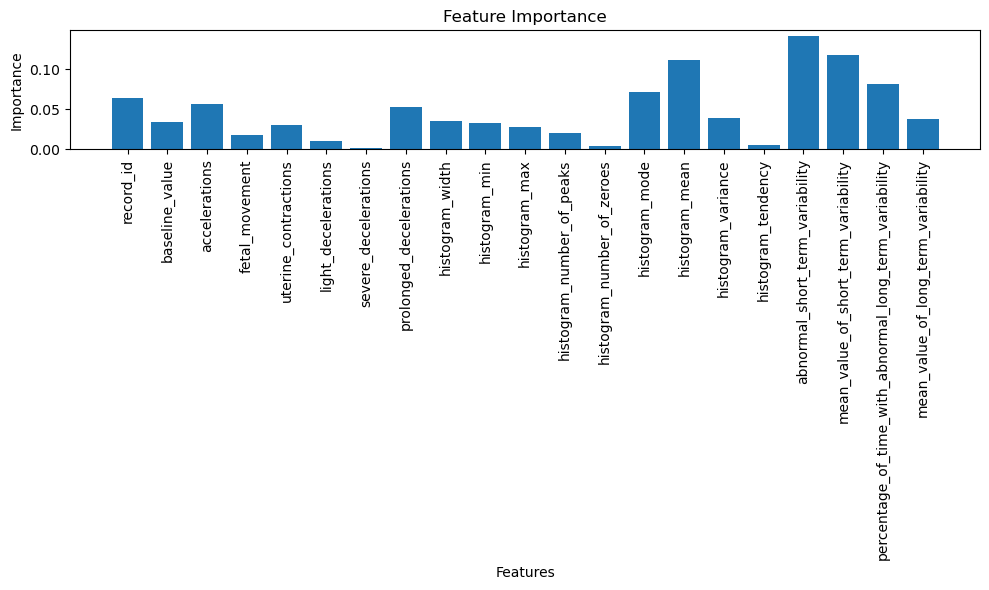

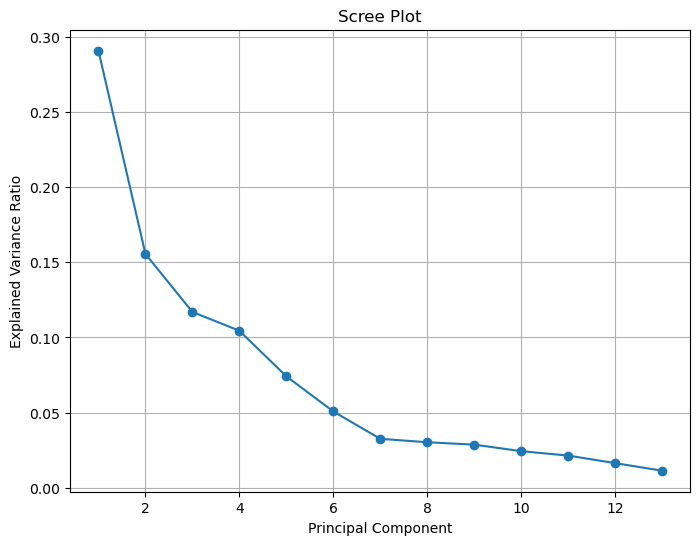

Number of components selected to retain 95% variance: 10


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
2024/12/21 03:10:15 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


🏃 View run PCA Experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/f4ac528050f64b6eba9fb59543a43fe6
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0


NameError: name 'scree_plot_path' is not defined

In [56]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
import mlflow
import dagshub
from mlflow.models.signature import infer_signature

# Initialize DagsHub with token
dagshub.init(repo_owner='HariniMurugan-2003', repo_name='Fetal_health_Fall24', mlflow=True)

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()

# Preprocessing pipeline
numerical_features = fetal.columns.tolist()  # Assuming all columns are numerical
numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),  # Standardization
    ('minmax', MinMaxScaler()),    # Min-Max scaling
    ('log_transform', FunctionTransformer(np.log1p))  # Log transformation
])

# Apply preprocessing using ColumnTransformer
preprocessor = ColumnTransformer([
    ('num', numerical_transformer, numerical_features)
])

# Feature Engineering: Apply PCA for dimensionality reduction
def apply_pca(data, n_components=0.95):
    # Standardize the data first
    data_scaled = preprocessor.fit_transform(data)
    
    # PCA to reduce dimensionality
    pca = PCA(n_components=n_components)
    pca_result = pca.fit_transform(data_scaled)
    
    # Create a DataFrame with the PCA components
    pca_df = pd.DataFrame(pca_result, columns=[f"PC{i+1}" for i in range(pca_result.shape[1])])
    
    # Explained variance plot (scree plot)
    plt.figure(figsize=(8, 6))
    plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, marker='o')
    plt.title('Scree Plot')
    plt.xlabel('Principal Component')
    plt.ylabel('Explained Variance Ratio')
    plt.grid(True)
    plt.show()
    
    return pca_df, pca

# Function to select the number of components based on the explained variance threshold
def select_n_components(pca_model, threshold=0.90):
    # Calculate the cumulative explained variance ratio
    cumulative_variance = np.cumsum(pca_model.explained_variance_ratio_)
    
    # Find the number of components that explain at least 'threshold' variance
    n_components = np.argmax(cumulative_variance >= threshold) + 1  # Adding 1 because index starts at 0
    
    return n_components, cumulative_variance

# Apply PCA to the dataset
fetal_pca, pca_model = apply_pca(fetal)

# Select the number of components based on the 95% explained variance threshold
n_components, cumulative_variance = select_n_components(pca_model)

print(f"Number of components selected to retain 95% variance: {n_components}")

# Log the PCA results in MLFlow
with mlflow.start_run(run_name="PCA Experiment"):
    # Log the PCA model
    signature = infer_signature(fetal, fetal_labels)
    mlflow.sklearn.log_model(pca_model, "pca_model", signature=signature)
    
    # Log PCA explained variance ratio
    for i, var_ratio in enumerate(pca_model.explained_variance_ratio_):
        mlflow.log_metric(f"Explained Variance Ratio PC{i+1}", var_ratio)

    # Log the number of components selected
    mlflow.log_metric("Selected Components", n_components)

    # Log the cumulative variance
    for i, variance in enumerate(cumulative_variance):
        mlflow.log_metric(f"Cumulative Variance PC{i+1}", variance)

    # Log the scree plot image
    plt.figure(figsize=(8, 6))
    plt.plot(range(1, len(pca_model.explained_variance_ratio_) + 1), pca_model.explained_variance_ratio_, marker='o')
    plt.title('Scree Plot')
    plt.xlabel('Principal Component')
    plt.ylabel('Explained Variance Ratio')
    plt.grid(True)
    
   

    print("PCA Experiment logged to MLFlow.")


# Step 13:
Using pipeline again for preprocessing the data to perform K-means clustering and store the resultant metrics such as - accuracies, F1 score and cofusion matrix into DAGSHUB.

In [63]:
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.cluster import KMeans
from sklearn.model_selection import cross_validate
from sklearn.metrics import f1_score
import mlflow
import dagshub
from mlflow.models.signature import infer_signature
import mlflow.sklearn

# Initialize DagsHub with token
dagshub.init(repo_owner='HariniMurugan-2003', repo_name='Fetal_health_Fall24', mlflow=True)

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()
fetal_labels = fetal_labels - 1  # Adjusting fetal_health if needed (assuming labels are starting from 0)

# Preprocessing steps
numerical_features = fetal.columns.tolist()

numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, numerical_features)
])

# Use KMeans instead of classifiers
kmeans = KMeans(n_clusters=3, random_state=42)  # Adjust the number of clusters if needed

results = {}

# Create a model pipeline for KMeans
model = Pipeline([
    ('preprocessor', preprocessor),
    ('kmeans', kmeans)
])

# Function to compute F1 Score for KMeans clustering
def compute_f1_score(true_labels, predicted_labels):
    return f1_score(true_labels, predicted_labels, average='weighted')

with mlflow.start_run(run_name="KMeans Clustering with F1 Score"):
    # Cross-validation with KMeans (using inertia as a scoring metric)
    cv_results = cross_validate(model, fetal, fetal_labels, cv=3, scoring='neg_mean_squared_error', return_train_score=True)
    
    # Log CV results
    mean_inertia = np.mean(cv_results['test_score'])
    std_inertia = np.std(cv_results['test_score'])
    
    mlflow.log_metric("CV Inertia Mean", -mean_inertia)  # Convert negative MSE to positive inertia
    mlflow.log_metric("CV Inertia Std", std_inertia)

    print(f"KMeans - CV Inertia Mean: {-mean_inertia}")
    print(f"KMeans - CV Inertia Std: {std_inertia}")

    # Fit the model to the entire dataset and predict labels
    model.fit(fetal)
    predicted_labels = model.predict(fetal)

    # Compute F1 score
    f1 = compute_f1_score(fetal_labels, predicted_labels)
    
    # Log F1 score
    mlflow.log_metric("F1 Score Mean", f1)
    
    print(f"KMeans - F1 Score: {f1}")

    # Log the model with MLFlow
    signature = infer_signature(fetal, fetal_labels)
    mlflow.sklearn.log_model(model, "model", signature=signature)
    
    # Register model in MLflow (optional)
    mlflow.register_model(f"runs:/{mlflow.active_run().info.run_id}/model", name="KMeans_Model")

    results["KMeans"] = {
        "mean_inertia": -mean_inertia,
        "std_inertia": std_inertia,
        "f1_score": f1
    }

# Results summary
print("Final Results:")
for name, metrics in results.items():
    print(f"{name}: Mean Inertia = {metrics['mean_inertia']}, Std Dev = {metrics['std_inertia']}, F1 Score = {metrics['f1_score']}")


Initialized MLflow to track repo "HariniMurugan-2003/Fetal_health_Fall24"

Repository HariniMurugan-2003/Fetal_health_Fall24 initialized!

KMeans - CV Inertia Mean: 1.6191906047169204
KMeans - CV Inertia Std: 0.4151880684155583
KMeans - F1 Score: 0.39254183560183614


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'KMeans_Model' already exists. Creating a new version of this model...
2024/12/21 03:11:09 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: KMeans_Mode

🏃 View run KMeans Clustering with F1 Score at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/778f873ff76a4b20b4d8aa0a06831cb7
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0
Final Results:
KMeans: Mean Inertia = 1.6191906047169204, Std Dev = 0.4151880684155583, F1 Score = 0.39254183560183614


# Step 14:
Performing Support Vector Machine using the preprossed data using pipeline. We store the resultant metrics such as - accuracies, F1 score and cofusion matrix back into DAGSHUB.

In [64]:
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.svm import SVC
from sklearn.model_selection import cross_validate
from sklearn.metrics import f1_score
import mlflow
import dagshub
from mlflow.models.signature import infer_signature
import mlflow.sklearn

# Initialize DagsHub with token
dagshub.init(repo_owner='HariniMurugan-2003', repo_name='Fetal_health_Fall24', mlflow=True)

# Assuming stratified split has already been performed
fetal = strat_train_set.drop("fetal_health", axis=1)
fetal_labels = strat_train_set["fetal_health"].copy()
fetal_labels = fetal_labels - 1  # Adjusting fetal_health if needed (assuming labels are starting from 0)

# Preprocessing steps
numerical_features = fetal.columns.tolist()

numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, numerical_features)
])

# Use SVM (Support Vector Machine) for classification
svm = SVC(random_state=42)

results = {}

# Create a model pipeline for SVM
model = Pipeline([
    ('preprocessor', preprocessor),
    ('svm', svm)
])

# Cross-validation with SVM and F1 score calculation
cv_results = cross_validate(model, fetal, fetal_labels, cv=3, scoring='f1_weighted', return_train_score=True)

# Log F1 scores (mean and std)
mean_f1 = np.mean(cv_results['test_score'])
std_f1 = np.std(cv_results['test_score'])

with mlflow.start_run(run_name="SVM with F1 Score"):
    mlflow.log_metric("F1 Score Mean", mean_f1)
    mlflow.log_metric("F1 Score Std", std_f1)

    print(f"SVM - F1 Score Mean: {mean_f1}")
    print(f"SVM - F1 Score Std: {std_f1}")

    # Log the model with MLFlow
    signature = infer_signature(fetal, fetal_labels)
    mlflow.sklearn.log_model(model, "model", signature=signature)
    
    # Register model in MLflow (optional)
    mlflow.register_model(f"runs:/{mlflow.active_run().info.run_id}/model", name="SVM_Model")

    results["SVM"] = {
        "mean_f1": mean_f1,
        "std_f1": std_f1
    }

# Results summary
print("Final Results:")
for name, metrics in results.items():
    print(f"{name}: Mean F1 = {metrics['mean_f1']}, Std Dev = {metrics['std_f1']}")


Initialized MLflow to track repo "HariniMurugan-2003/Fetal_health_Fall24"

Repository HariniMurugan-2003/Fetal_health_Fall24 initialized!

SVM - F1 Score Mean: 0.9121071533936801
SVM - F1 Score Std: 0.0114828624717145


/opt/anaconda3/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
Registered model 'SVM_Model' already exists. Creating a new version of this model...
2024/12/21 03:11:21 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: SVM_Model, ver

🏃 View run SVM with F1 Score at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0/runs/6240811bdd9b464d91e56ff8bc81c6d7
🧪 View experiment at: https://dagshub.com/HariniMurugan-2003/Fetal_health_Fall24.mlflow/#/experiments/0
Final Results:
SVM: Mean F1 = 0.9121071533936801, Std Dev = 0.0114828624717145


# Step 15:
After performing all of the above steps and modelling in multiple models such as Logistic Regression, Ridge Classifier, Random Forest, XGBoost,SVM, we now check for the best model.
To find the best model we visualize all models and their metrics using visualization tools, which leads use to having XGBoost as the best model.

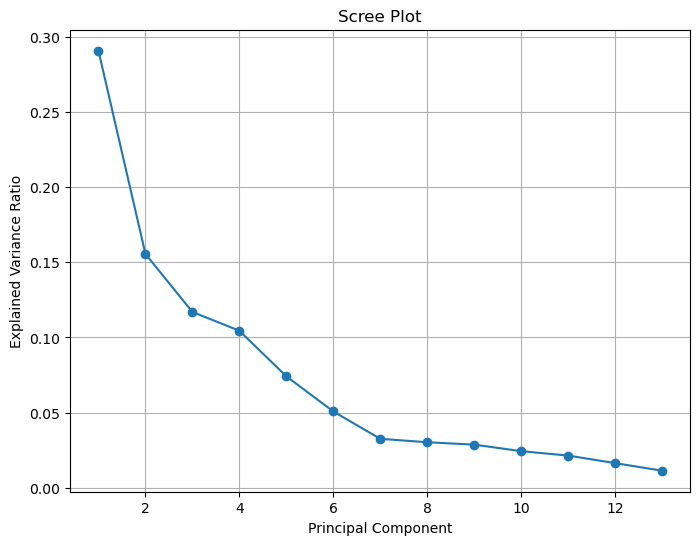

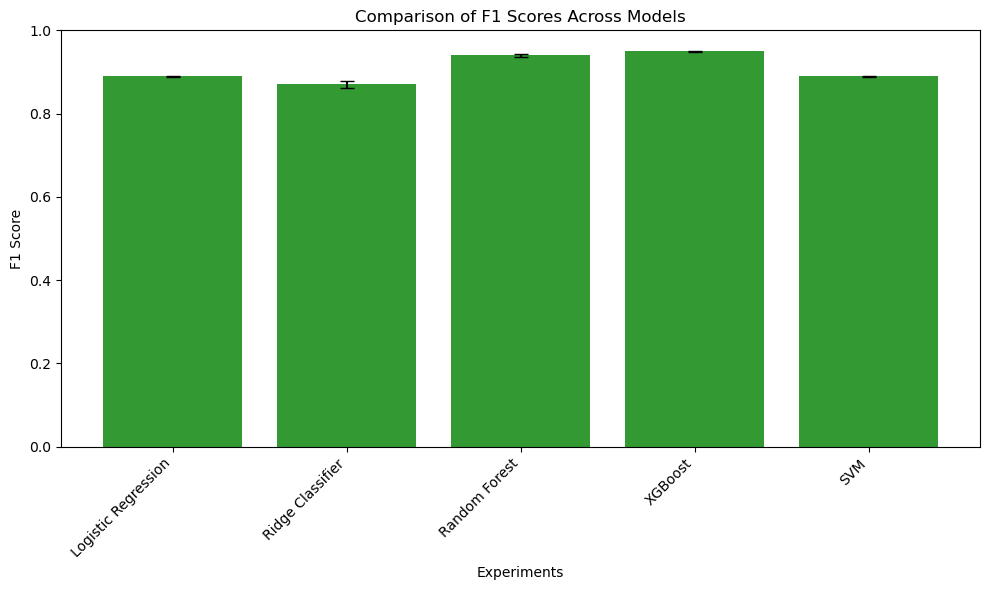

In [65]:
import matplotlib.pyplot as plt
import pandas as pd

# Example data: Replace this with actual values logged in MLFlow
experiment_results = { 
    "Experiment": ["Logistic Regression", "Ridge Classifier", "Random Forest", "XGBoost","SVM"],
    "F1_Mean": [0.89, 0.87,0.94, 0.95, 0.89],  # Use actual F1 mean values
    "F1_Std": [0.001, 0.008,0.003, 0.001, 0.001],    # Use actual F1 std values
}

# Create a DataFrame
df_results = pd.DataFrame(experiment_results)

# Plot F1 scores with error bars
plt.figure(figsize=(10, 6))
plt.bar(df_results["Experiment"], df_results["F1_Mean"], yerr=df_results["F1_Std"], capsize=5, color='Green', alpha=0.8)
plt.xlabel("Experiments")
plt.ylabel("F1 Score")
plt.title("Comparison of F1 Scores Across Models")
plt.ylim(0, 1)  # F1 scores range from 0 to 1
plt.xticks(rotation=45, ha="right")
plt.tight_layout()

# Save the plot if needed
plt.savefig("f1_score_comparison.png")

# Show the plot
plt.show()

# Step 16: 
After preprocessing and training the model for XGBoost we store it with joblib.

In [66]:
import joblib
from xgboost import XGBClassifier
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.model_selection import train_test_split

# Split data into training and testing sets
fetal_train, fetal_test, fetal_train_labels, fetal_test_labels = train_test_split(
    fetal, fetal_labels, test_size=0.2, random_state=42
)

# Preprocessing pipeline
numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, fetal.columns.tolist())
])

# XGBoost model pipeline
xgb_model = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', XGBClassifier())
])

# Train the model
xgb_model.fit(fetal_train, fetal_train_labels)

# Save the trained model
joblib_file = "xgboost_model.joblib"
joblib.dump({"model": xgb_model}, joblib_file)

print(f"Model trained and saved to {joblib_file}")


Model trained and saved to xgboost_model.joblib


# Note:
Although XGBoost is the best model, it's only 1 percent better than Random Forest. Since I am facing an error when modeling XGBoost while importing its necessary packages with a docker file, I have proceeded with Random Forest, which has the next-best accuracy.

# Step 16: 
After preprocessing and training the model for Random Forest we store it with joblib.

In [67]:
import joblib
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, FunctionTransformer
from sklearn.model_selection import train_test_split

# Split data into training and testing sets
fetal_train, fetal_test, fetal_train_labels, fetal_test_labels = train_test_split(
    fetal, fetal_labels, test_size=0.2, random_state=42
)

# Preprocessing pipeline
numerical_transformer = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler()),
    ('log_transform', FunctionTransformer(np.log1p))
])

preprocessor = ColumnTransformer([
    ('num', numerical_transformer, fetal.columns.tolist())
])

# Random Forest model pipeline
rf_model = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier())
])

# Train the model
rf_model.fit(fetal_train, fetal_train_labels)

# Save the trained model
joblib_file = "random_forest_model.joblib"
joblib.dump({"model": rf_model}, joblib_file)

print(f"Model trained and saved to {joblib_file}")


Model trained and saved to random_forest_model.joblib


In [68]:
joblib_file = "random_forest_model.joblib"
loaded_data = joblib.load(joblib_file)
model_rf = loaded_data['model']
print(model_rf.predict(fetal))

[0. 2. 1. ... 0. 0. 0.]


In [69]:
type(loaded_data)

dict

In [70]:
joblib.dump(model_rf, 'model_rf_new.joblib')

['model_rf_new.joblib']

In [71]:
type(model_rf)

sklearn.pipeline.Pipeline

# Step 17:
Here we proceed with moving this model into a Streamlit application.

In [72]:
a_row=fetal.iloc[0]
a_row.to_dict()

{'record_id': 87.0,
 'baseline_value': 145.0,
 'accelerations': 0.008,
 'fetal_movement': 0.0,
 'uterine_contractions': 0.002,
 'light_decelerations': 0.0,
 'severe_decelerations': 0.0,
 'prolonged_decelerations': 0.0,
 'histogram_width': 117.0,
 'histogram_min': 50.0,
 'histogram_max': 167.0,
 'histogram_number_of_peaks': 4.0,
 'histogram_number_of_zeroes': 0.0,
 'histogram_mode': 154.0,
 'histogram_mean': 151.0,
 'histogram_median': 154.0,
 'histogram_variance': 16.0,
 'histogram_tendency': 1.0,
 'abnormal_short_term_variability': 41.0,
 'mean_value_of_short_term_variability': 1.8,
 'percentage_of_time_with_abnormal_long_term_variability': 0.0,
 'mean_value_of_long_term_variability': 23.4}

In [73]:
!pip install requests

In [115]:

data = a_row.to_dict()
print(data)

{'record_id': 87.0, 'baseline_value': 145.0, 'accelerations': 0.008, 'fetal_movement': 0.0, 'uterine_contractions': 0.002, 'light_decelerations': 0.0, 'severe_decelerations': 0.0, 'prolonged_decelerations': 0.0, 'histogram_width': 117.0, 'histogram_min': 50.0, 'histogram_max': 167.0, 'histogram_number_of_peaks': 4.0, 'histogram_number_of_zeroes': 0.0, 'histogram_mode': 154.0, 'histogram_mean': 151.0, 'histogram_median': 154.0, 'histogram_variance': 16.0, 'histogram_tendency': 1.0, 'abnormal_short_term_variability': 41.0, 'mean_value_of_short_term_variability': 1.8, 'percentage_of_time_with_abnormal_long_term_variability': 0.0, 'mean_value_of_long_term_variability': 23.4}


# Step 18:
Now we deploy the Streamlit application for the model.

In [ ]:
import requests
import json


# Send the request as JSON
r = requests.post('http://127.0.0.1:8000/predict', json=data)

# Check the response
print(r.json())


In [98]:
import math
import pandas as pd
from collections import defaultdict
import json

# Load data
data = pd.read_csv('fetal_health_from_db.csv')
print(data)


# Define fields
slider_fields = {   
    "record_id"
    "baseline_value",
    "accelerations",
    "fetal_movement",
    "uterine_contractions",
    "light_decelerations",
    "severe_decelerations",
    "prolonged_decelerations",
    "histogram_width",
    "histogram_min",
    "histogram_max",
    "histogram_number_of_peaks",
    "histogram_number_of_zeroes",
    "histogram_mode",
    "histogram_mean",
    "histogram_median",
    "histogram_variance",
    "abnormal_short_term_variability",
    "mean_value_of_short_term_variability",
    "percentage_of_time_with_abnormal_long_term_variability",
    "mean_value_of_long_term_variability"
}

single_select_fields = ["histogram_tendency"]

# Initialize defaultdict for nested dictionaries
streamlit_field_data = defaultdict(lambda: defaultdict(dict))

# Compute ranges for slider fields
streamlit_field_data["slider_fields"] = {}
for field in slider_fields:
    if field in data.columns:
        try:
            streamlit_field_data["slider_fields"][field] = [
                int(math.floor(data[field].min())),  # Convert to int
                int(math.ceil(data[field].max())),   # Convert to int
            ]
        except Exception as e:
            print(f"Error processing slider field {field}: {e}")

# Compute unique values for single select fields
streamlit_field_data["single_select_fields"] = {}
for field in single_select_fields:
    if field in data.columns:
        try:
            # Convert all unique values to Python native types
            streamlit_field_data["single_select_fields"][field] = [str(val) for val in sorted(data[field].unique())]
        except Exception as e:
            print(f"Error processing single select field {field}: {e}")

# Save as JSON
def convert_to_serializable(obj):
    """Recursively convert non-serializable objects to serializable types."""
    if isinstance(obj, (np.int64, np.int32)):
        return int(obj)
    if isinstance(obj, (np.float64, np.float32)):
        return float(obj)
    if isinstance(obj, dict):
        return {key: convert_to_serializable(value) for key, value in obj.items()}
    if isinstance(obj, list):
        return [convert_to_serializable(item) for item in obj]
    return obj

# Convert the data to serializable format and save to JSON
serializable_data = convert_to_serializable(streamlit_field_data)
with open("streamlit_options.json", "w") as f:
    json.dump(serializable_data, f, indent=2)

print("Data saved to streamlit_options.json")

      record_id  baseline_value  accelerations  fetal_movement  \
0             1           120.0          0.000           0.000   
1             2           132.0          0.006           0.000   
2             3           133.0          0.003           0.000   
3             4           134.0          0.003           0.000   
4             5           132.0          0.007           0.000   
...         ...             ...            ...             ...   
1703       2121           140.0          0.000           0.000   
1704       2122           140.0          0.000           0.000   
1705       2123           140.0          0.001           0.000   
1706       2125           140.0          0.001           0.000   
1707       2126           142.0          0.002           0.002   

      uterine_contractions  light_decelerations  severe_decelerations  \
0                    0.000                0.000                   0.0   
1                    0.006                0.003              

In [ ]:
import requests
import json

# Define the payload as a Python dictionary
data = {
    "record_id": 87.0,
    "baseline_value": 145.0,
    "accelerations": 0.008,
    "fetal_movement": 0.0,
    "uterine_contractions": 0.002,
    "light_decelerations": 0.0,
    "severe_decelerations": 0.0,
    "prolonged_decelerations": 0.0,
    "histogram_width": 117.0,
    "histogram_min": 50.0,
    "histogram_max": 167.0,
    "histogram_number_of_peaks": 4.0,
    "histogram_number_of_zeroes": 0.0,
    "histogram_mode": 154.0,
    "histogram_mean": 151.0,
    "histogram_median": 154.0,
    "histogram_variance": 16.0,
    "histogram_tendency": 1.0,
    "abnormal_short_term_variability": 41.0,
    "mean_value_of_short_term_variability": 1.8,
    "percentage_of_time_with_abnormal_long_term_variability": 0.0,
    "mean_value_of_long_term_variability": 23.4
}

# Send the request as JSON
r = requests.post('http://127.0.0.1:8000/predict', json=data)

# Print the response
print(r.json())